In [1]:
import os.path as osp
import cv2
import numpy as np

import sys
sys.path.append('../../../') 

from dust3r.datasets.base.base_stereo_view_dataset import BaseStereoViewDataset
from dust3r.utils.image import imread_cv2
from dust3r.datasets import UnderWaterDataset

In [2]:
dataset = UnderWaterDataset(split='train', ROOT='/home/aleksandra/dense_glomap_output', resolution=224)

100%|██████████| 3510/3510 [19:36<00:00,  2.98it/s]

LEN selected_pairs 2068


In [3]:
def index_check(index=0):
    print(dataset.selected_pairs[index])
    print(dataset[index][0]['instance'], dataset[index][1]['instance'], )

In [4]:
index_check(0)
index_check(1)
index_check(10)
index_check(-1)
index_check(-2)
index_check(-10)

(164, 177, np.float32(2565.9814), np.float32(0.21394643))
00000164.png 00000177.png
(164, 181, np.float32(2144.0486), np.float32(0.20924148))
00000164.png 00000181.png
(176, 193, np.float32(1802.752), np.float32(0.21803255))
00000176.png 00000193.png
(150, 167, np.float32(0.007054772), np.float32(0.04201798))
00000150.png 00000167.png
(98, 113, np.float32(0.008667204), np.float32(0.065913625))
00000098.png 00000113.png
(215, 232, np.float32(0.028720478), np.float32(0.12034253))
00000215.png 00000232.png


In [5]:
print(len(dataset.split_data))
selected_pairs = dataset.selected_pairs
print(len(selected_pairs))

249
2068


In [6]:
selected_pairs[:10]

[(164, 177, np.float32(2565.9814), np.float32(0.21394643)),
 (164, 181, np.float32(2144.0486), np.float32(0.20924148)),
 (165, 178, np.float32(2135.9092), np.float32(0.19637597)),
 (166, 177, np.float32(2083.5657), np.float32(0.17925207)),
 (165, 176, np.float32(2055.9138), np.float32(0.17813203)),
 (165, 180, np.float32(2007.3314), np.float32(0.20419312)),
 (177, 192, np.float32(1973.4174), np.float32(0.22187841)),
 (175, 192, np.float32(1956.201), np.float32(0.22073087)),
 (164, 179, np.float32(1855.4851), np.float32(0.19860572)),
 (175, 194, np.float32(1810.0398), np.float32(0.22151084))]

In [7]:
selected_pairs[-10:]

[(215, 232, np.float32(0.028720478), np.float32(0.12034253)),
 (154, 171, np.float32(0.026428074), np.float32(0.08144112)),
 (116, 145, np.float32(0.026338074), np.float32(0.081301786)),
 (124, 149, np.float32(0.023390178), np.float32(0.10851654)),
 (72, 99, np.float32(0.022997605), np.float32(0.10759577)),
 (75, 98, np.float32(0.018322164), np.float32(0.09597135)),
 (154, 167, np.float32(0.010813363), np.float32(0.05203475)),
 (37, 54, np.float32(0.010302573), np.float32(0.07188079)),
 (98, 113, np.float32(0.008667204), np.float32(0.065913625)),
 (150, 167, np.float32(0.007054772), np.float32(0.04201798))]

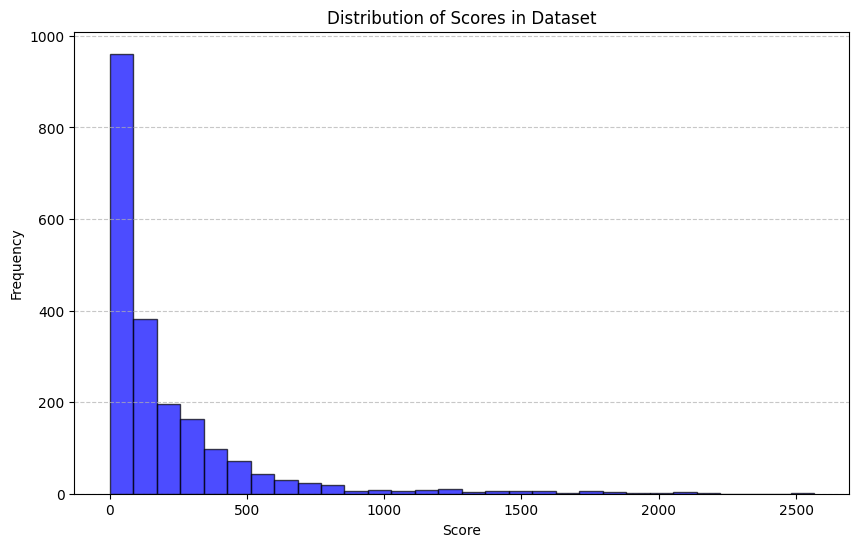

In [18]:
import matplotlib.pyplot as plt

data_pairs = dataset.selected_pairs  

scores = [entry[2] for entry in data_pairs] 

plt.figure(figsize=(10, 6))
plt.hist(scores, bins=30, color='blue', alpha=0.7, edgecolor='black')
plt.title('Distribution of Scores in Dataset')
plt.xlabel('Score')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

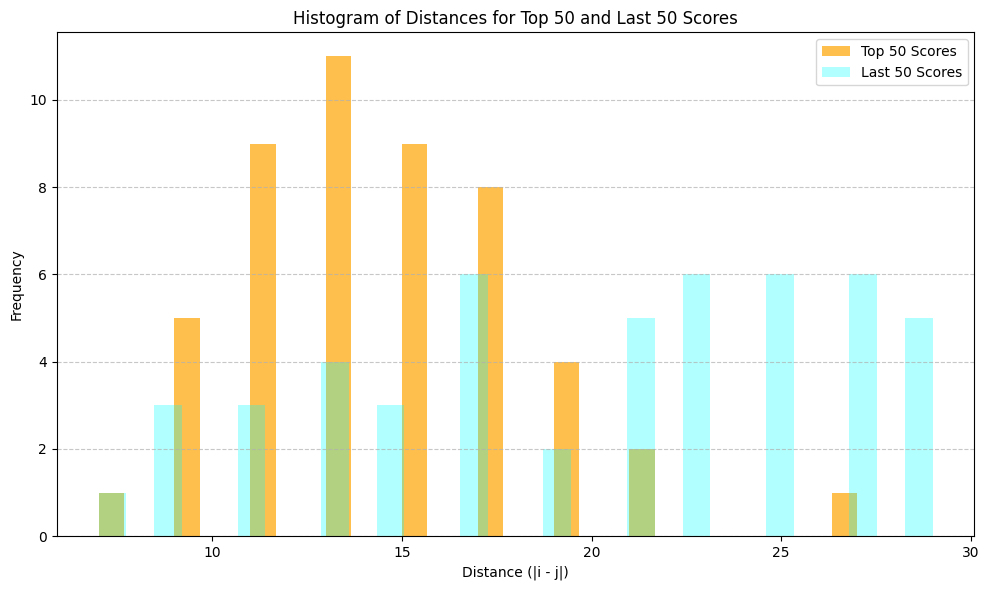

In [19]:
top_50_scores = sorted(scores, reverse=True)[:50]
last_50_scores = sorted(scores)[:50]

top_50_distances = [abs(entry[0] - entry[1]) for entry in data_pairs if entry[2] in top_50_scores]
last_50_distances = [abs(entry[0] - entry[1]) for entry in data_pairs if entry[2] in last_50_scores]

plt.figure(figsize=(10, 6))
plt.hist(top_50_distances, bins=30, color='orange', alpha=0.7, label='Top 50 Scores')
plt.hist(last_50_distances, bins=30, color='cyan', alpha=0.3, label='Last 50 Scores')
plt.title('Histogram of Distances for Top 50 and Last 50 Scores')
plt.xlabel('Distance (|i - j|)')
plt.ylabel('Frequency')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


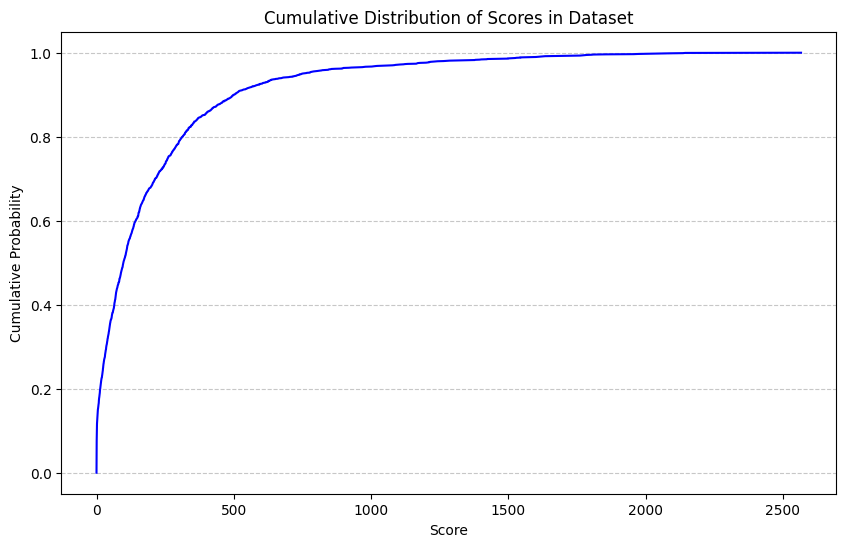

In [10]:
import matplotlib.pyplot as plt

data_pairs = dataset.selected_pairs  

scores = [entry[2] for entry in data_pairs] 

plt.figure(figsize=(10, 6))
plt.plot(sorted(scores), np.linspace(0, 1, len(scores)), color='blue', alpha=1)
plt.title('Cumulative Distribution of Scores in Dataset')
plt.xlabel('Score')
plt.ylabel('Cumulative Probability')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

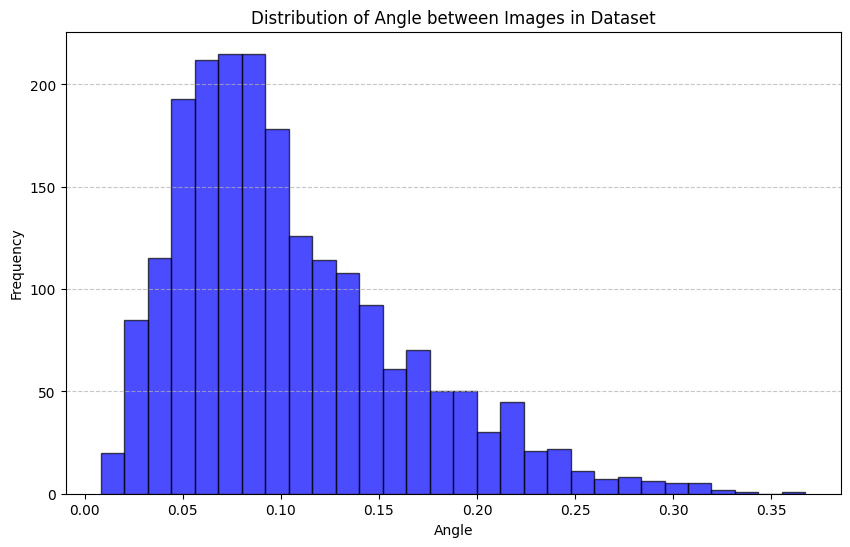

In [11]:
import matplotlib.pyplot as plt

data_pairs = dataset.selected_pairs  

scores = [entry[3] for entry in data_pairs] 

plt.figure(figsize=(10, 6))
plt.hist(scores, bins=30, color='blue', alpha=0.7, edgecolor='black')
plt.title('Distribution of Angle between Images in Dataset')
plt.xlabel('Angle')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()

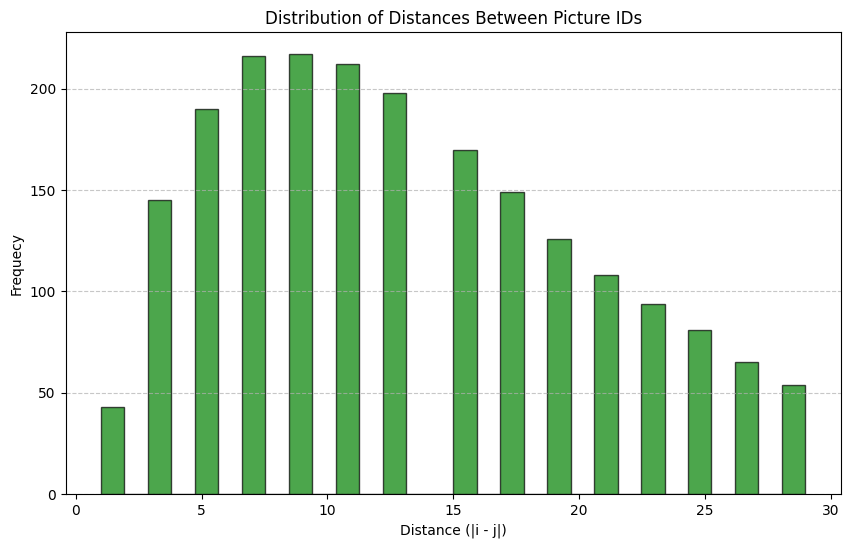

In [12]:
distances = [abs(entry[0] - entry[1]) for entry in data_pairs] 

plt.figure(figsize=(10, 6))
plt.hist(distances, bins=30, color='green', alpha=0.7, edgecolor='black')
plt.title('Distribution of Distances Between Picture IDs')
plt.xlabel('Distance (|i - j|)')
plt.ylabel('Frequecy')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


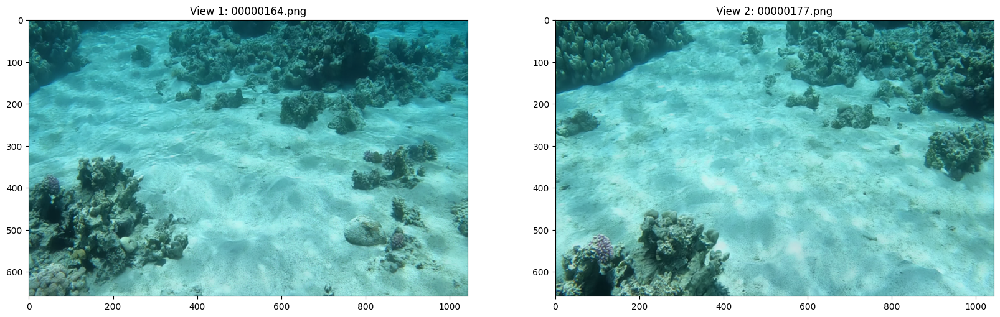

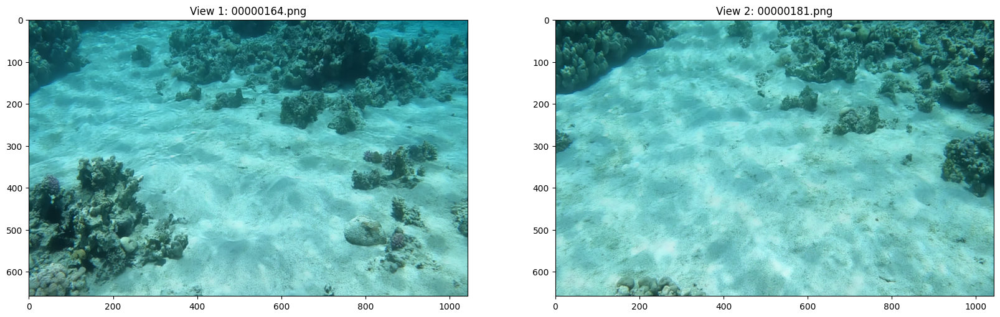

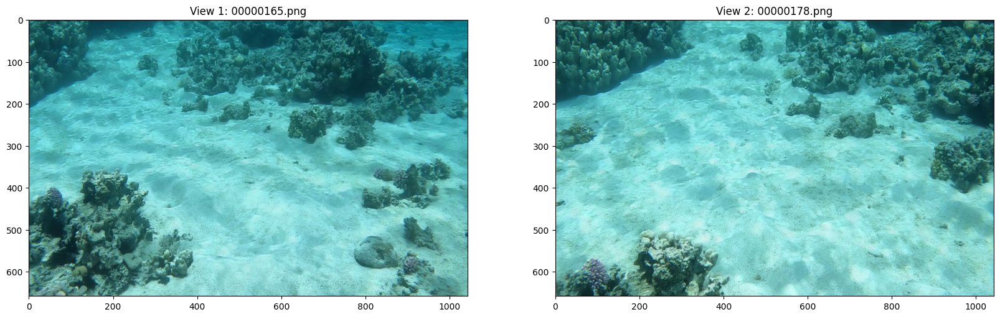

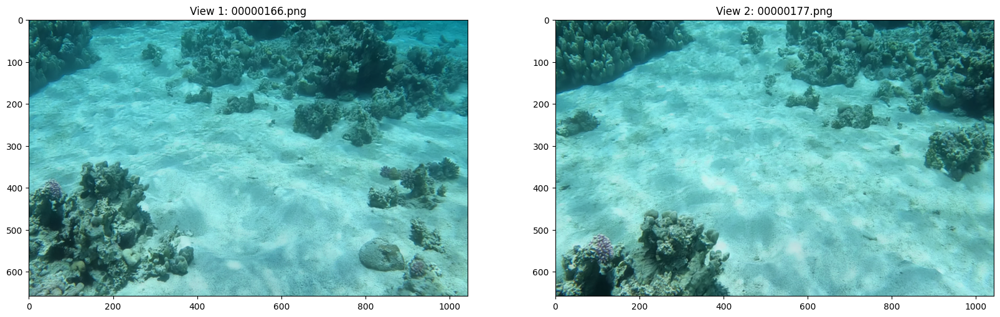

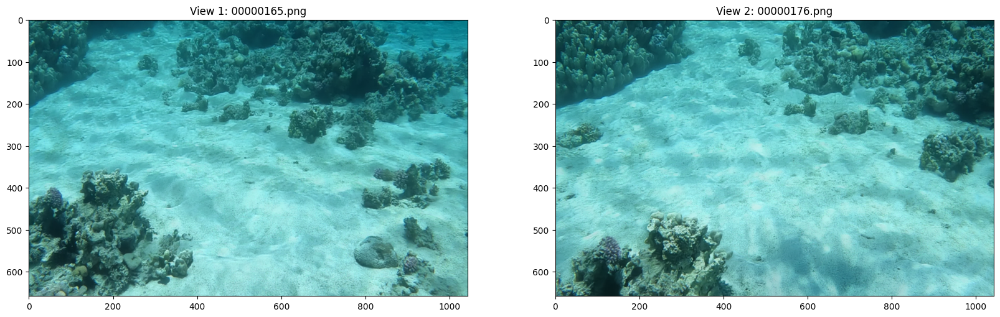

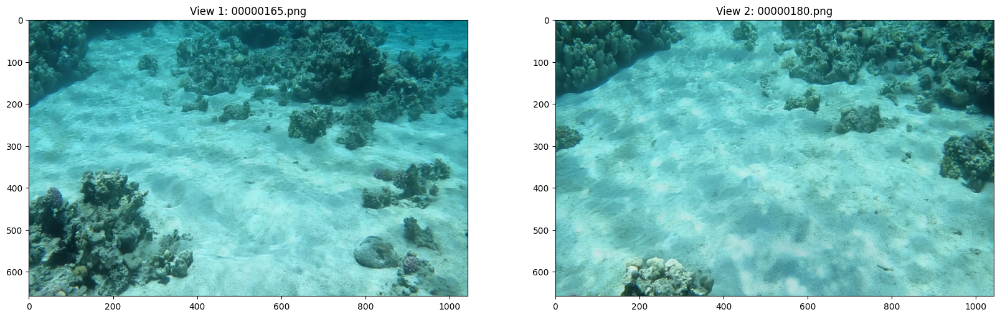

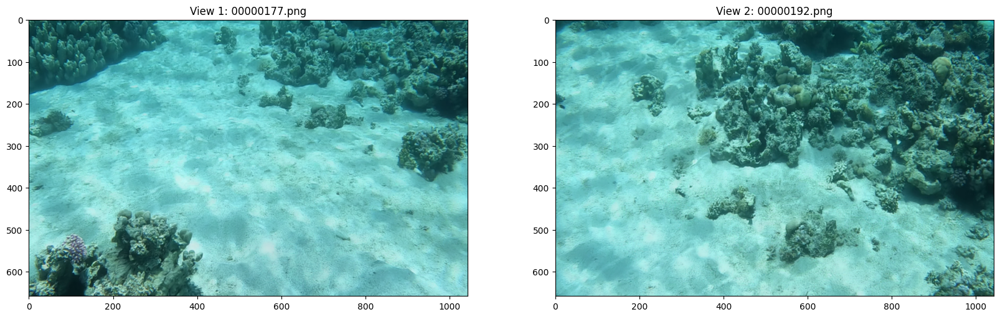

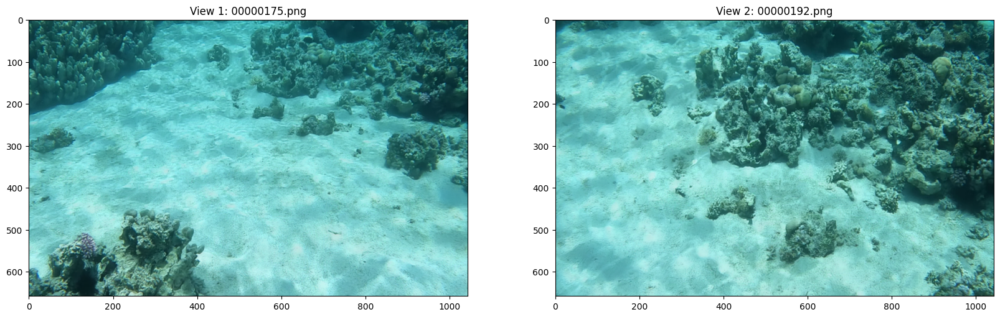

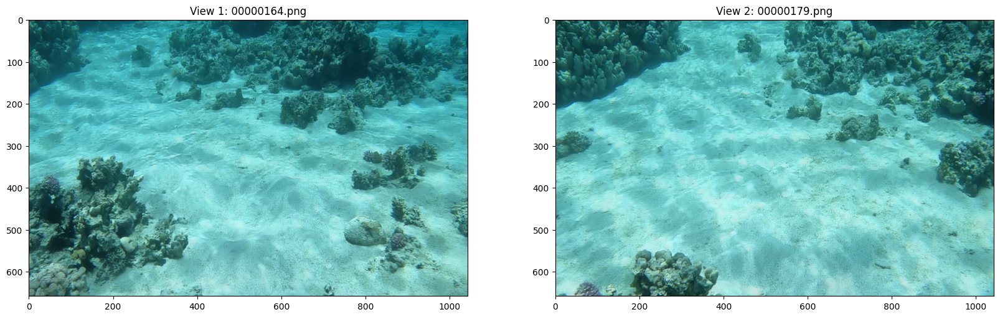

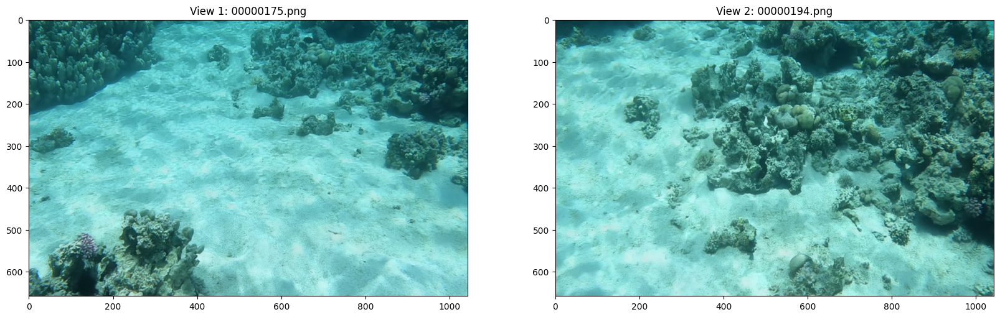

In [13]:
import matplotlib.pyplot as plt
import os.path as osp
import cv2


for i in range(10):
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    
    root = dataset[i][0]['label']
    name1 = dataset[i][0]['instance']
    name2 = dataset[i][1]['instance']
    
    rgb_image_path = osp.join(root, dataset.images_path, name1)
    rgb_image1 = imread_cv2(rgb_image_path)
    
    rgb_image_path = osp.join(root, dataset.images_path, name2)
    rgb_image2 = imread_cv2(rgb_image_path)
    
    axs[0].imshow(rgb_image1)
    axs[0].set_title(f'View 1: {name1}')

    axs[1].imshow(rgb_image2)
    axs[1].set_title(f'View 2: {name2}')

    plt.show()

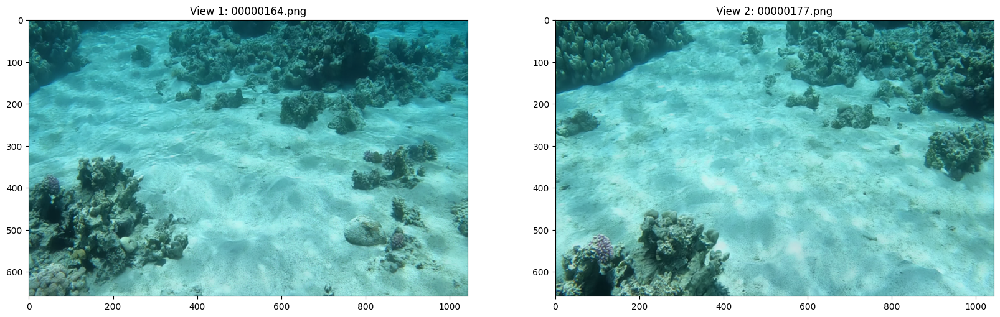

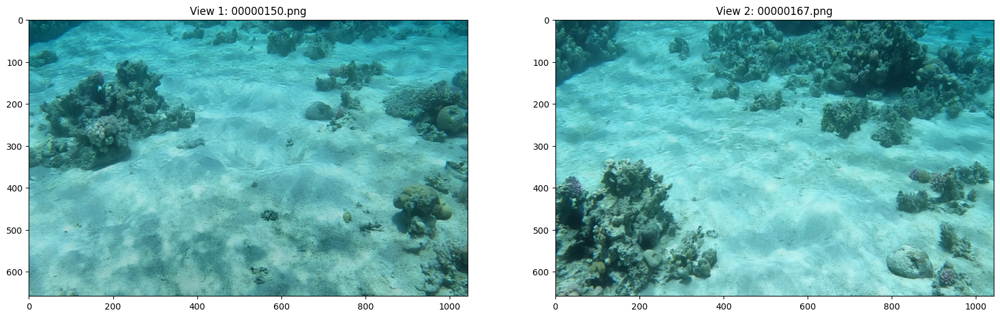

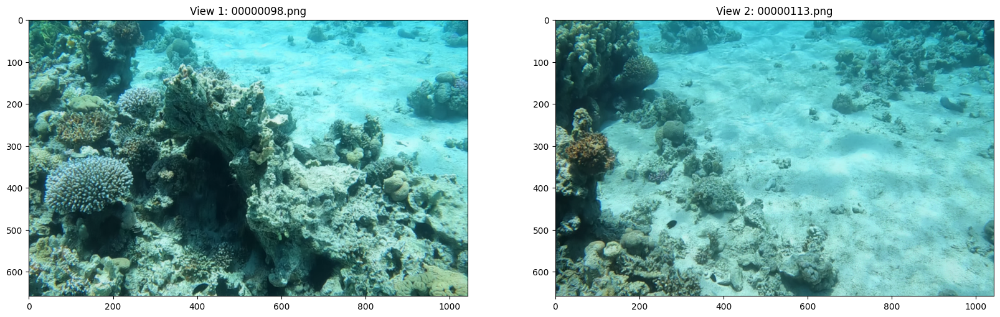

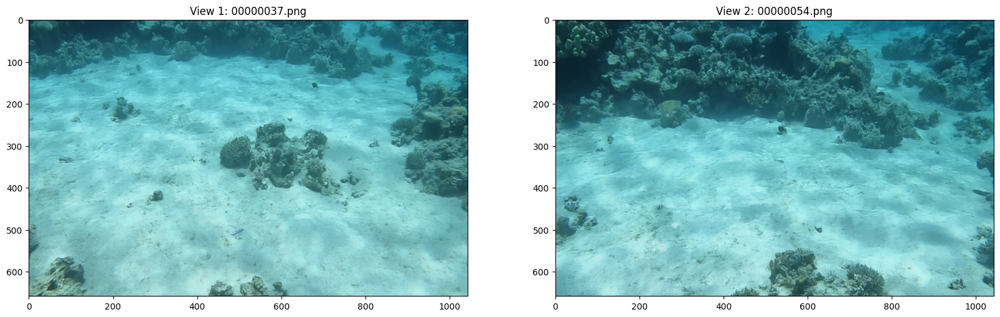

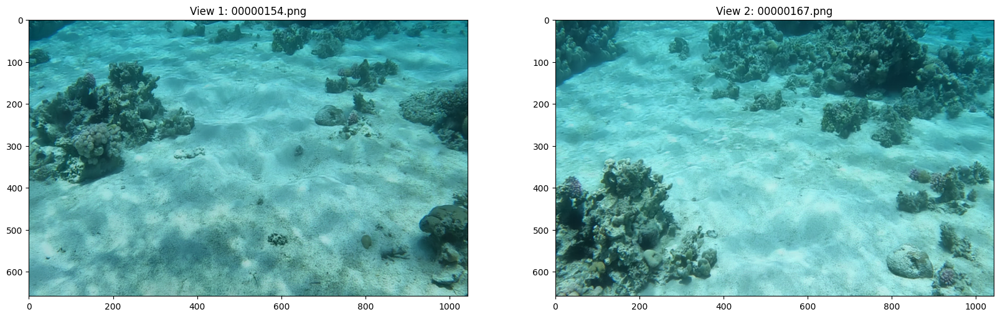

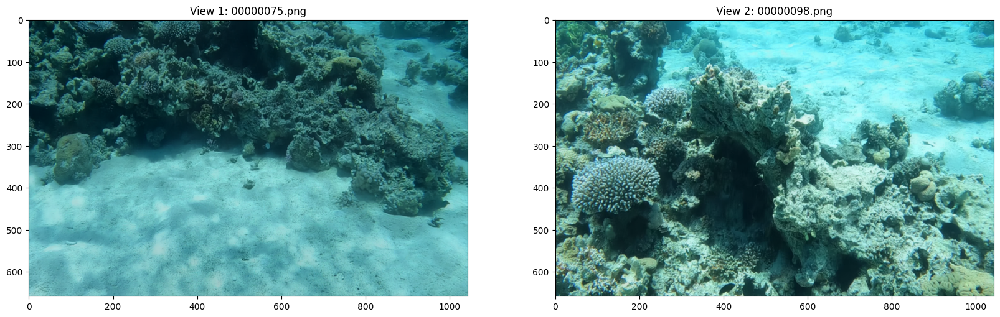

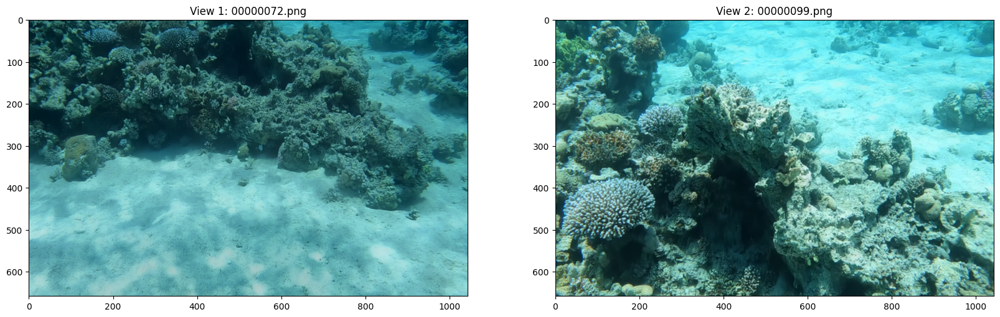

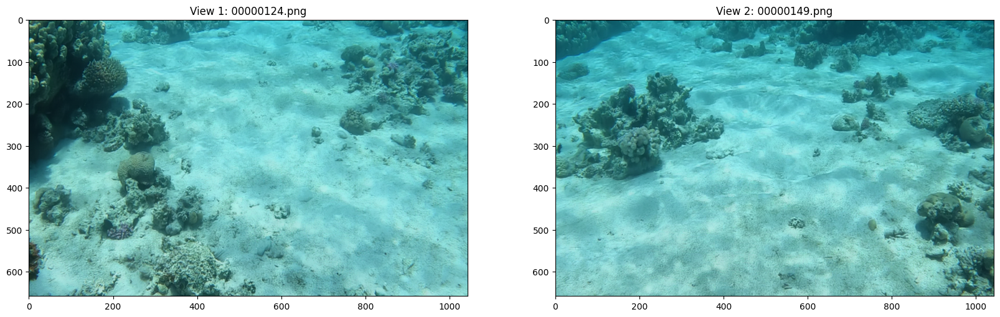

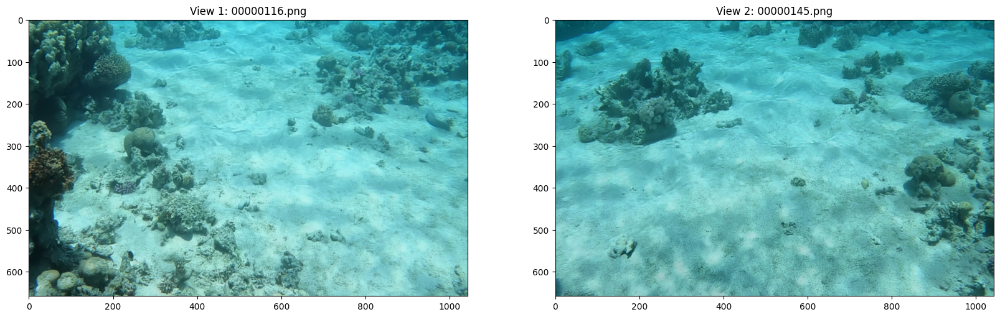

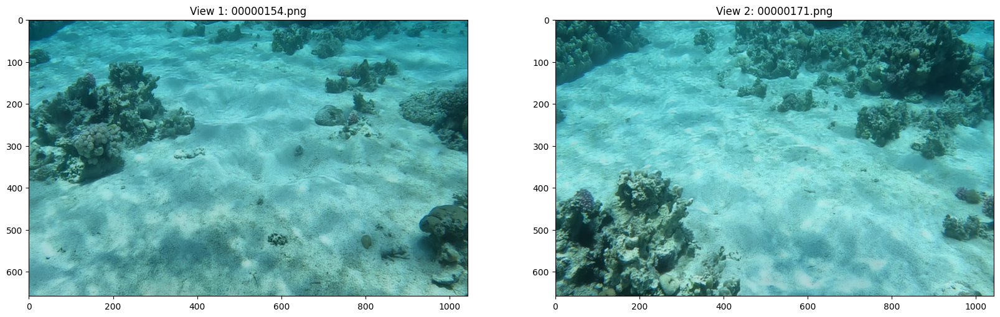

In [14]:
import matplotlib.pyplot as plt
import os.path as osp
import cv2


for i in range(10):
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    
    root = dataset[-i][0]['label']
    name1 = dataset[-i][0]['instance']
    name2 = dataset[-i][1]['instance']
    
    rgb_image_path = osp.join(root, dataset.images_path, name1)
    rgb_image1 = imread_cv2(rgb_image_path)
    
    rgb_image_path = osp.join(root, dataset.images_path, name2)
    rgb_image2 = imread_cv2(rgb_image_path)
    
    axs[0].imshow(rgb_image1)
    axs[0].set_title(f'View 1: {name1}')

    axs[1].imshow(rgb_image2)
    axs[1].set_title(f'View 2: {name2}')

    plt.show()

In [15]:
# np.transpose(dataset[0][0]['img'], (1, 2, 0)).shape

In [16]:
# import matplotlib.pyplot as plt
# 
# for i in range(10):
#     fig, axs = plt.subplots(1, 2, figsize=(10, 5))
#     
#     views1 = dataset[i][0]['img']
#     views1 = np.transpose(views1, (1, 2, 0))
#     
#     views2 = dataset[i][1]['img']
#     views2 = np.transpose(views2, (1, 2, 0))
#     
#     axs[0].imshow(views1)
#     axs[0].set_title('View 1')
# 
#     axs[1].imshow(views2)
#     axs[1].set_title('View 2')
# 
#     plt.show()